## Reinforcement Learning exercise: MsPacman
https://ale.farama.org/environments/ms_pacman/



## OpenAI gym

https://gymnasium.farama.org/


OpenAI gym is a great toolkit for developing and comparing Reinforcement Learning algorithms. It provides many environments for your learning *agents* to interact with.

In [43]:
#from google.colab import drive
#drive.mount('/content/drive')
#drive.flush_and_unmount()

In [44]:
import os
ML_IMAGES_DIR = "test"

In [45]:
!pip install gymnasium[atari] ale-py autorom
!AutoROM --accept-license

AutoROM will download the Atari 2600 ROMs.
They will be installed to:
	/usr/local/lib/python3.12/dist-packages/AutoROM/roms

Existing ROMs will be overwritten.


In [46]:
import gymnasium as gym
import ale_py
gym.register_envs(ale_py)

Load the MsPacman environment, version 4.

In [47]:
env = gym.make('MsPacman-v4', render_mode='rgb_array')

Initialize the environment by calling is `reset()` method. This returns an observation:

In [48]:
obs = env.reset()

Observations vary depending on the environment. In this case it is an RGB image represented as a 3D NumPy array of shape [width, height, channels] (with 3 channels: Red, Green and Blue). In other environments it may return different objects, as we will see later.

In [49]:
obs[0].shape

(210, 160, 3)

An environment can be visualized by calling its `render()` method, and you can pick the rendering mode (the rendering options depend on the environment). In this example we will set `mode="rgb_array"` to get an image of the environment as a NumPy array:

In [50]:
img = env.render()

Plot this image:

In [51]:
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import numpy as np

Saving figure 


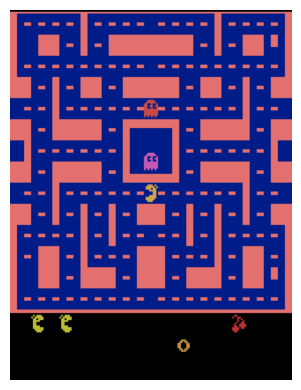

In [52]:
def save_fig(fig_id, tight_layout=True, fig_extension="png",
             resolution=300):
    path = os.path.join(ML_IMAGES_DIR,
                        fig_id + "." + fig_extension)
    print("Saving figure", fig_id)
    if tight_layout:
        plt.tight_layout()
    os.makedirs(ML_IMAGES_DIR, exist_ok=True)
    plt.savefig(path, format=fig_extension, dpi=resolution)
plt.figure(figsize=(5,4))
plt.imshow(img)
plt.axis("off")
save_fig("")
plt.show()

In this environment, the rendered image is simply equal to the observation (but in many environments this is not the case):

In [53]:
(img == obs[0]).all()

np.True_

Create a little helper function to plot an environment:

In [54]:
def plot_environment(env, figsize=(5,4)):
    plt.close()  # or else nbagg sometimes plots in the previous cell
    plt.figure(figsize=figsize)
    img = env.render()
    plt.imshow(img)
    plt.axis("off")
    plt.show()

Let's see how to interact with an environment. Your agent will need to select an action from an "action space" (the set of possible actions). Let's see what this environment's action space looks like:

In [55]:
env.action_space

Discrete(9)

`Discrete(9)` means that the possible actions are integers 0 through 8, which represents the 9 possible positions of the joystick (0=center, 1=up, 2=right, 3=left, 4=down, 5=upper-right, 6=upper-left, 7=lower-right, 8=lower-left).

Next we need to tell the environment which action to play, and it will compute the next step of the game. Let's go left for 110 steps, then lower left for 40 steps:

In [56]:
env.reset()
for step in range(110):
    env.step(3) #left
for step in range(40):
    env.step(8) #lower-left

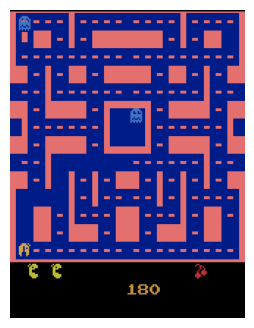

In [57]:
plot_environment(env)

The `step()` function actually returns several important objects:

In [58]:
obs, reward, terminated, truncated, info = env.step(0)

The observation tells the agent what the environment looks like, as discussed earlier. This is a 210x160 RGB image:

In [59]:
obs.shape

(210, 160, 3)

The environment also tells the agent how much reward it got during the last step:

In [60]:
reward

0.0

When the game is over, the environment returns `done=True`:

In [61]:
terminated

False

Finally, `info` is an environment-specific dictionary that can provide some extra information about the internal state of the environment. This is useful for debugging, but your agent should not use this information for learning (it would be cheating).

In [62]:
info

{'lives': 3, 'episode_frame_number': 458, 'frame_number': 458}

Let's play one full game (with 3 lives), by moving in random directions for 10 steps at a time, recording each frame:

In [63]:
frames = []
n_max_steps = 1000
n_change_steps = 10
obs, info = env.reset()
for step in range(n_max_steps):
    img = env.render()
    frames.append(img)
    if step % n_change_steps == 0:
        action = env.action_space.sample() # play randomly
    obs, reward, terminated, truncated,
    info = env.step(action)
    if terminated or truncated:
        break

Now show the animation:

In [64]:
def update_scene(num, frames, patch):
    patch.set_data(frames[num])
    return patch,
def plot_animation(frames, repeat=False,
    interval=40):
    # plt.close()  # Removed to prevent AttributeError with animation cleanup
    fig = plt.figure()
    patch = plt.imshow(frames[0])
    plt.axis('off')
    return animation.FuncAnimation(fig,
    update_scene,fargs=(frames, patch),
    frames=len(frames),
    repeat=repeat, interval=interval)

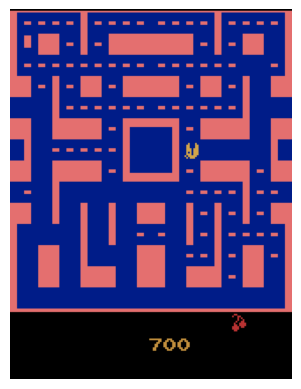

In [65]:
from IPython.display import HTML
video = plot_animation(frames)
HTML(video.to_jshtml())

Once you have finished playing with an environment, you should close it to free up resources:

In [ ]:
env.close()